In [ ]:
# took reference from official docs
# https://github.com/Project-MONAI/tutorials/blob/main/3d_segmentation/spleen_segmentation_3d_visualization_basic.ipynb

In [1]:
!pip install -q "monai-weekly[gdown, nibabel, tqdm, ignite]"
!python -c "import matplotlib" || pip install -q matplotlib
%matplotlib inline

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [15]:
# %%capture
!pip install matplotlib numpy tqdm glob2 dicom2nifti pytest-shutil nibabel

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [16]:
# %%capture
! pip install nibabel pillow tensorboard gdown itk tqdm lmdb psutil cucim pandas einops transformers mlflow matplotlib tensorboardX tifffile imagecodecs pyyaml fire jsonschema pynrrd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
%%capture
!tar -xvf '/content/drive/Shareddrives/HelpingCodingPeoples/Task02_Heart.tar' -C '/content/'

In [17]:
# %%capture
!pip install monai

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
%%capture
!pip install 'monai[all]'

In [2]:
import os 
import torch 
from glob import glob
import numpy as np
import pandas as pd

from monai.transforms import (Compose , LoadImaged ,
                              ToTensord , AddChanneld , Spacingd , 
                              ScaleIntensityRanged, CropForegroundd, 
                              Resized
)

from monai.data import Dataset , DataLoader
from monai.utils import first
import matplotlib.pyplot as plt

In [8]:
!pip install -q aim

     |████████████████████████████████| 5.5 MB 5.1 MB/s 
     |████████████████████████████████| 281 kB 64.8 MB/s 
     |████████████████████████████████| 4.0 MB 34.0 MB/s 
     |████████████████████████████████| 210 kB 71.1 MB/s 
     |████████████████████████████████| 53 kB 2.1 MB/s 
     |████████████████████████████████| 6.1 MB 11.0 MB/s 
     |████████████████████████████████| 3.1 MB 44.0 MB/s 
     |████████████████████████████████| 55 kB 2.8 MB/s 
     |████████████████████████████████| 4.0 MB 49.8 MB/s 
     |████████████████████████████████| 51 kB 390 kB/s 
     |████████████████████████████████| 22.1 MB 1.3 MB/s 
     |████████████████████████████████| 78 kB 7.8 MB/s 
     |████████████████████████████████| 60 kB 7.1 MB/s 
     |████████████████████████████████| 11.1 MB 49.6 MB/s 
     |████████████████████████████████| 58 kB 5.6 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the

In [13]:
!python -c "import monai" || pip install -q "monai-weekly[gdown, nibabel, tqdm, ignite]"

!python -c "import matplotlib" || pip install -q matplotlib

In [3]:
from monai.utils import first, set_determinism
from monai.transforms import (
    AsDiscrete,
    AsDiscreted,
    EnsureChannelFirstd,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandCropByPosNegLabeld,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    EnsureTyped,
    EnsureType,
    Invertd,
)
from monai.handlers.utils import from_engine
from monai.networks.nets import UNet
from monai.networks.layers import Norm
from monai.metrics import DiceMetric
from monai.losses import DiceLoss
from monai.inferers import sliding_window_inference
from monai.data import CacheDataset, DataLoader, Dataset, decollate_batch
from monai.config import print_config
from monai.apps import download_and_extract
import aim
from aim.pytorch import track_gradients_dists, track_params_dists
import torch
import matplotlib.pyplot as plt
import tempfile
import shutil
import os


In [20]:
# from torch.utils.data import Dataset ,IterableDataset
# from torchvision import datasets
# from torch.utils.data import DataLoader

In [4]:
len(os.listdir('/content/Task02_Heart/imagesTr/')) == len(os.listdir('/content/Task02_Heart/labelsTr/'))

False

In [5]:
data_dir = '/content/Task02_Heart/'

train_images = sorted(glob(os.path.join(data_dir,'imagesTr','*nii.gz'))) # this gives all the file path
train_labels = sorted(glob(os.path.join(data_dir,'labelsTr/','*nii.gz'))) # this will give train label path

test_images = sorted(glob(os.path.join(data_dir,'imagesTs/','*nii.gz'))) 

print(f'Length of train set = {len(os.listdir(os.path.join(data_dir,"imagesTr/")))}')
print(f'Length of test set = {len(os.listdir(os.path.join(data_dir,"imagesTs/")))}')

Length of train set = 21
Length of test set = 10


In [6]:
train_files = [{"images": image_name ,
                "label": label_name} for image_name , label_name in zip(train_images,train_labels)]

In [7]:

orign_transforms = Compose([
    LoadImaged(keys=['images','label']),
    AddChanneld(keys=['images','label']),
    
    ToTensord(keys=['images','label'])
])

train_transforms = Compose([
    LoadImaged(keys=['images','label']),
    AddChanneld(keys=['images','label']),
    Spacingd(keys=['images','label'],pixdim=(1.5,1.5,2)),
    ScaleIntensityRanged(keys='images',a_min=-200,
                         a_max=200,b_min=0.0,
                         b_max=1.0,clip=True),
    CropForegroundd(keys=['images','label'],source_key='images'),
    Resized(keys=['images','label'],spatial_size=[128,128,128]),
    
    
    ToTensord(keys=['images','label'])
])

In [8]:
orig_ds = CacheDataset(train_files,transform=orign_transforms)
orig_loader = DataLoader(orig_ds,batch_size=1)

train_ds = CacheDataset(train_files,transform=train_transforms)
train_loader = DataLoader(train_ds,batch_size=1)

Loading dataset: 100%|██████████| 20/20 [00:32<00:00,  1.63s/it]


In [9]:
!nvidia-smi

Sat May 28 06:17:47 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

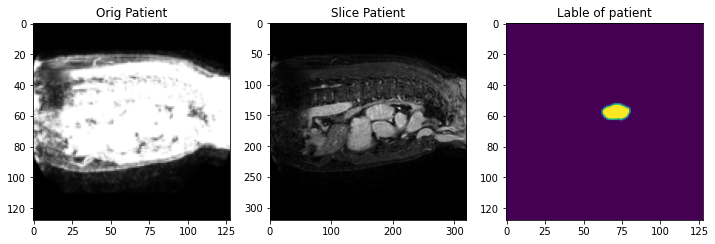

In [10]:
# get a file from original transform and train transform
train_patient = first(train_loader)
orig_patient = first(orig_loader)

image_t , label_t = (train_patient['images'][0][0], train_patient['label'][0][0])
image_o , label_o = (orig_patient['images'][0][0], orig_patient['label'][0][0])

plt.figure("train",(12,6))

plt.subplot(1,3,1)
plt.title("Orig Patient")
plt.imshow(image_t[:,:,80],cmap="gray")


plt.subplot(1,3,2)
plt.title("Slice Patient")
plt.imshow(image_o[:,:,80],cmap="gray")

plt.subplot(1,3,3)
plt.title("Lable of patient")
plt.imshow(label_t[:,:,80])

plt.show()

In [11]:
len(train_patient)

8

In [12]:
train_patient['images'].shape

torch.Size([1, 1, 128, 128, 128])

In [13]:
(train_patient['images'][0][0], train_patient['label'][0][0])

(tensor([[[0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          ...,
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000]],
 
         [[0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          ...,
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000]],
 
         [[0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ..., 0.5000, 0.5000, 0.5000],
          [0.5000, 0.5000, 0.5000,  ...,

## Training Process

In [14]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [15]:
UNet_meatdata = dict(
    spatial_dims=3,
    in_channels=1,
    out_channels=2,
    channels=(16, 32, 64, 128, 256),
    strides=(2, 2, 2, 2),
    num_res_units=2,
    norm=Norm.BATCH
)

In [16]:

model = UNet(**UNet_meatdata).to(device)
loss_function = DiceLoss(to_onehot_y=True, softmax=True)
loss_type = "DiceLoss"
optimizer = torch.optim.Adam(model.parameters(), 1e-4)
dice_metric = DiceMetric(include_background=False, reduction="mean")

Optimizer_metadata = {}
for ind, param_group in enumerate(optimizer.param_groups):
    optim_meta_keys = list(param_group.keys())
    Optimizer_metadata[f'param_group_{ind}'] = {key: value for (key, value) in param_group.items() if 'params' not in key}

In [17]:
max_epochs = 600
val_interval = 10
best_metric = -1
best_metric_epoch = -1
epoch_loss_values = []
metric_values = []
post_pred = Compose([EnsureType(), AsDiscrete(argmax=True, to_onehot=2)])
post_label = Compose([EnsureType(), AsDiscrete(to_onehot=2)])

root_dir = '/content/Task02_Heart'

# initialize a new Aim Run
aim_run = aim.Run()
# log model metadata
aim_run['UNet_meatdata'] = UNet_meatdata
# log optimizer metadata
aim_run['Optimizer_metadata'] = Optimizer_metadata

slice_to_track = 80

for epoch in range(max_epochs):
    print("-" * 10)
    print(f"epoch {epoch + 1}/{max_epochs}")
    model.train()
    epoch_loss = 0
    step = 0
    for batch_data in train_loader:
        step += 1
        inputs, labels = (
            batch_data["images"].to(device),
            batch_data["label"].to(device),
        )
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        print(f"{step}/{len(train_ds) // train_loader.batch_size}, "
            f"train_loss: {loss.item():.4f}")
        # track batch loss metric
        aim_run.track(loss.item(), name="batch_loss", context={'type':loss_type})
        
    epoch_loss /= step
    epoch_loss_values.append(epoch_loss)
    
    # track epoch loss metric
    aim_run.track(epoch_loss, name="epoch_loss", context={'type':loss_type})

    print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")

    if (epoch + 1) % val_interval == 0:
        if (epoch + 1) % val_interval * 2 == 0:
            # track model params and gradients
            track_params_dists(model,aim_run)
            # THIS SEGMENT TAKES RELATIVELY LONG (Advise Against it)
            track_gradients_dists(model, aim_run)
        
        model.eval()
        with torch.no_grad():
            for index, val_data in enumerate(orig_loader):
                val_inputs, val_labels = (
                    val_data["images"].to(device),
                    val_data["label"].to(device),
                )
                roi_size = (160, 160, 160)
                sw_batch_size = 4
                val_outputs = sliding_window_inference(
                    val_inputs, roi_size, sw_batch_size, model)
                
                # tracking input, label and output images with Aim
                output = torch.argmax(val_outputs, dim=1)[0, :, :, slice_to_track].float()
                
                aim_run.track(aim.Image(val_inputs[0, 0, :, :, slice_to_track], \
                                        caption=f'Input Image: {index}'), \
                               name='validation', context={'type':'input'})
                aim_run.track(aim.Image(val_labels[0, 0, :, :, slice_to_track], \
                                        caption=f'Label Image: {index}'), \
                               name='validation', context={'type':'label'})
                aim_run.track(aim.Image(output, caption=f'Predicted Label: {index}'), \
                               name = 'predictions', context={'type':'labels'}) 

                val_outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
                val_labels = [post_label(i) for i in decollate_batch(val_labels)]
                # compute metric for current iteration
                dice_metric(y_pred=val_outputs, y=val_labels)
            
            # aggregate the final mean dice result
            metric = dice_metric.aggregate().item()
            # track val metric
            aim_run.track(metric, name="val_metric", context={'type':loss_type})

            # reset the status for next validation round
            dice_metric.reset()

            metric_values.append(metric)
            if metric > best_metric:
                best_metric = metric
                best_metric_epoch = epoch + 1
                torch.save(model.state_dict(), os.path.join(
                    root_dir, "best_metric_model.pth"))
                
                best_model_log_message = f"saved new best metric model at the {epoch+1}th epoch"
                aim_run.track(aim.Text(best_model_log_message), name='best_model_log_message', epoch=epoch+1)
                print(best_model_log_message)
                
            message1 = f"current epoch: {epoch + 1} current mean dice: {metric:.4f}"
            message2 = f"\nbest mean dice: {best_metric:.4f} "
            message3 = f"at epoch: {best_metric_epoch}"
    
            aim_run.track(aim.Text(message1 +"\n" + message2 + message3), name='epoch_summary', epoch=epoch+1)
            print(message1, message2, message3)

Streaming output truncated to the last 5000 lines.
12/20, train_loss: 0.0062
13/20, train_loss: 0.0071
14/20, train_loss: 0.0058
15/20, train_loss: 0.0055
16/20, train_loss: 0.0056
17/20, train_loss: 0.0068
18/20, train_loss: 0.0193
19/20, train_loss: 0.0097
20/20, train_loss: 0.0087
epoch 385 average loss: 0.0084
----------
epoch 386/600
1/20, train_loss: 0.0100
2/20, train_loss: 0.0092
3/20, train_loss: 0.0224
4/20, train_loss: 0.0080
5/20, train_loss: 0.0064
6/20, train_loss: 0.0055
7/20, train_loss: 0.0064
8/20, train_loss: 0.0073
9/20, train_loss: 0.0059
10/20, train_loss: 0.0075
11/20, train_loss: 0.0078
12/20, train_loss: 0.0081
13/20, train_loss: 0.0069
14/20, train_loss: 0.0085
15/20, train_loss: 0.0068
16/20, train_loss: 0.0060
17/20, train_loss: 0.0084
18/20, train_loss: 0.0192
19/20, train_loss: 0.0092
20/20, train_loss: 0.0066
epoch 386 average loss: 0.0088
----------
epoch 387/600
1/20, train_loss: 0.0124
2/20, train_loss: 0.0112
3/20, train_loss: 0.0233
4/20, train_loss:

In [ ]:
!sudo apt-get install libleptonica-dev tesseract-ocr tesseract-ocr-dev libtesseract-dev python3-pil tesseract-ocr-eng tesseract-ocr-script-latn

In [ ]:
!pip install tesseract
!pip install tesseract-ocr

In [24]:
!pip install pillow==4.1.1
%reload_ext autoreload
%autoreload

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.3 MB 4.6 MB/s 
     |████████████████████████████████| 112 kB 65.4 MB/s 
  Created wheel for pillow: filename=Pillow-4.1.1-cp37-cp37m-linux_x86_64.whl size=1009685 sha256=6cee636852339b81ada385a8e01ef84bdd89099960752639ead96f5a532a5266
  Stored in directory: /root/.cache/pip/wheels/51/53/67/d76ff9fd54dd89a25efce20d2e7c9b35348db386b53deb8095
  Created wheel for olefile: filename=olefile-0.46-py2.py3-none-any.whl size=35432 sha256=a572474a354f7a3a57958b4e8316604ca441f343f47853c5b2754e0355252ed5
  Stored in directory: /root/.cache/pip/wheels/84/53/e6/37d90ccb3ad1a3ca98d2b17107e9fda401a7c541ea1eb6a65a
Successfully built pillow olefile
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.1.1
    Uninstalling Pillow-9.1.1:
      Successfully uninstalled Pillow-9.1.1
ERROR: pip's dependency resolver does not currently take into accou

In [26]:
# workaround 
from PIL import Image
def register_extension(id, extension): Image.EXTENSION[extension.lower()] = id.upper()
Image.register_extension = register_extension
def register_extensions(id, extensions): 
  for extension in extensions: register_extension(id, extension)
Image.register_extensions = register_extensions

In [28]:
!pip install Pillow==4.0.0 # this worked
!pip install PIL
!pip install image

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.1 MB 5.3 MB/s 
  Created wheel for Pillow: filename=Pillow-4.0.0-cp37-cp37m-linux_x86_64.whl size=1007283 sha256=132a2b9ef17efdb27b1f7fd561d37870404b39eeb287240ab250bbf6dc136014
  Stored in directory: /root/.cache/pip/wheels/ec/1e/24/dbc5e4964ea99cad93230a9013d934fb5adc322c3102f69e45
Successfully built Pillow
  Attempting uninstall: Pillow
    Found existing installation: Pillow 4.1.1
    Uninstalling Pillow-4.1.1:
      Successfully uninstalled Pillow-4.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.12.0+cu113 requires pillow!=8.3.*,>=5.3.0, but you have pillow 4.0.0 which is incompatible.
scikit-image 0.18.3 requires pillow!=7.1.0,!=7.1.1,>=4.3.0, but you have pillow 4.0.0 which is incompatible.
bokeh

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement PIL (from versions: none)
ERROR: No matching distribution found for PIL
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 7.9 MB 5.0 MB/s 
  Created wheel for image: filename=image-1.5.33-py2.py3-none-any.whl size=19496 sha256=34210b00224440b75f88dc00bd3dd943516453a41c74cc574c25bc6fe021ae0d
  Stored in directory: /root/.cache/pip/wheels/56/88/e6/897194cfe8c08a8b9afd881d3bf53d102e13fa39607d721383
Successfully built image


In [18]:
aim_run.close()

In [19]:
print(
    f"train completed, best_metric: {best_metric:.4f} "
    f"at epoch: {best_metric_epoch}")

train completed, best_metric: 0.0143 at epoch: 520


In [20]:
%load_ext aim
%aim up

<IPython.core.display.Javascript object>

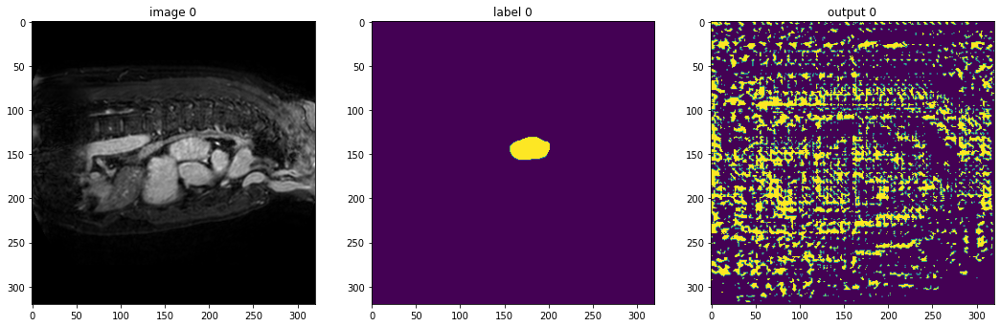

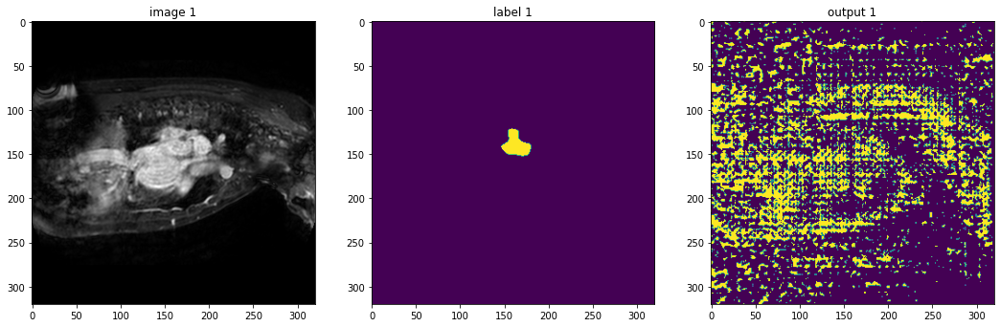

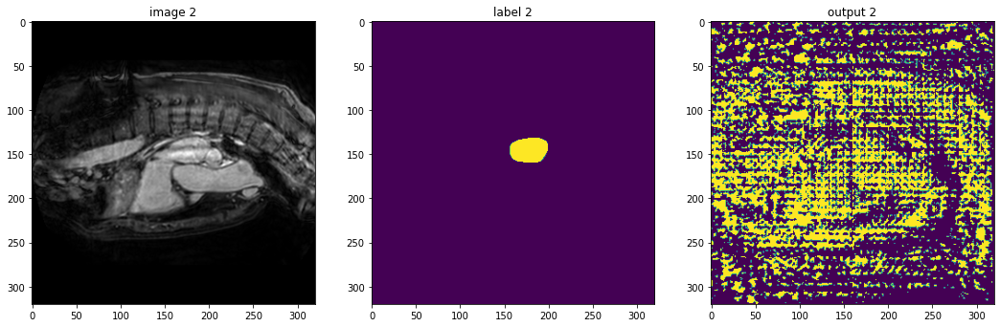

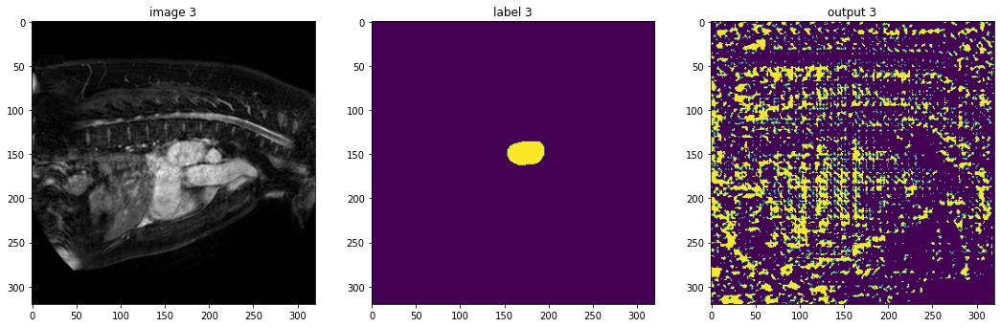

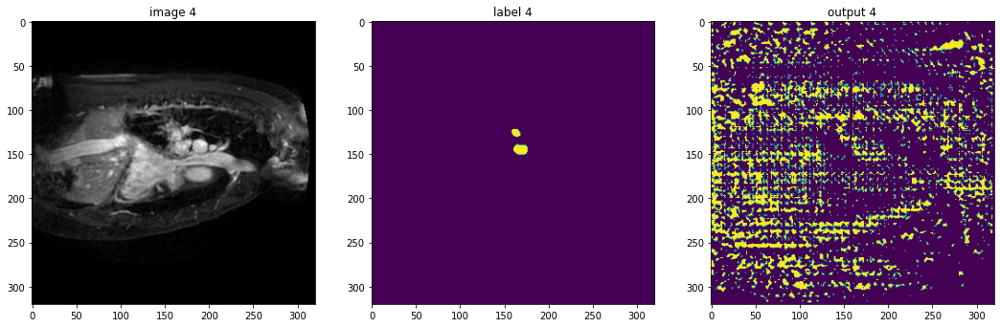

...

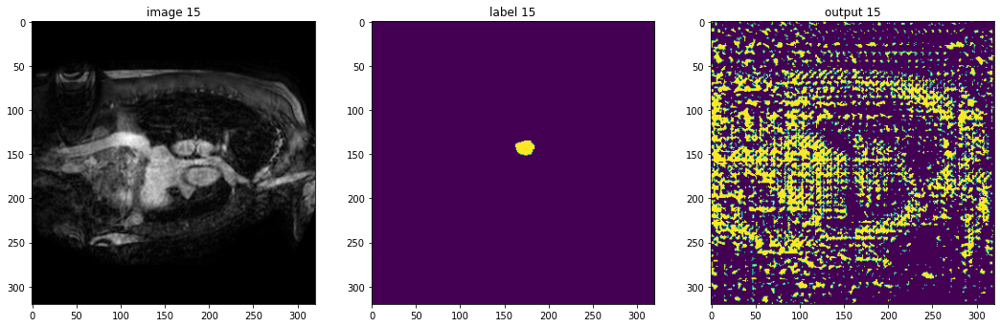

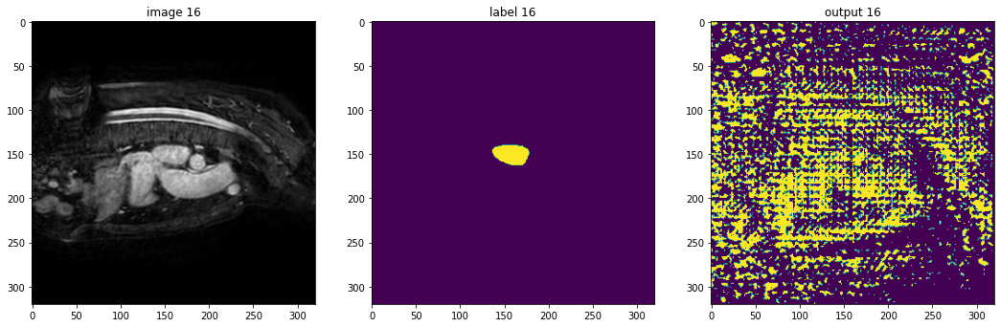

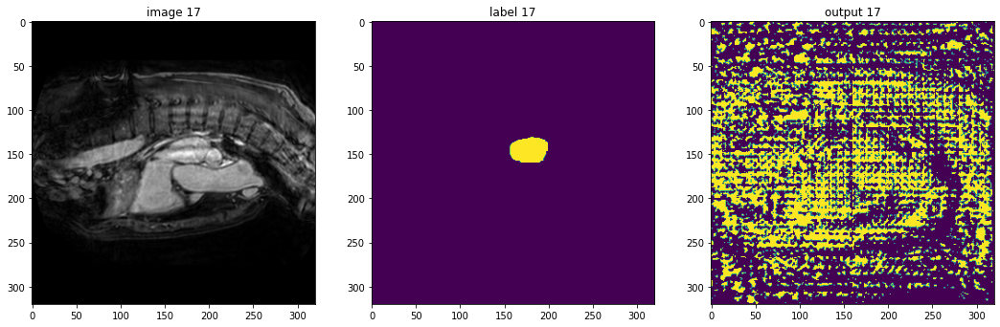

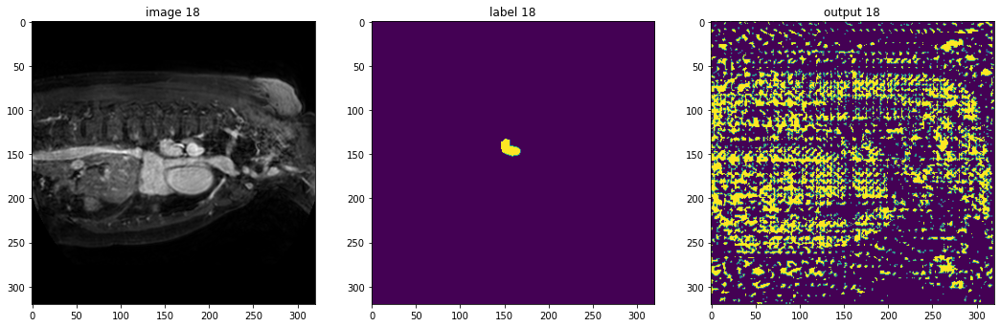

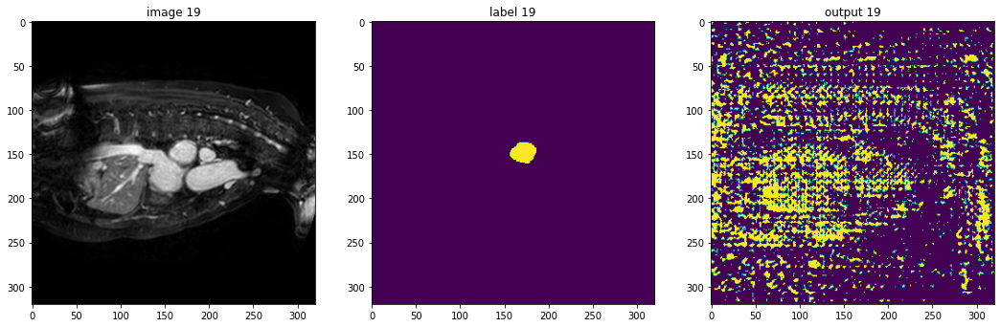

In [26]:
model.load_state_dict(torch.load(
    os.path.join(root_dir, "best_metric_model.pth")))
model.eval()
with torch.no_grad():
    for i, val_data in enumerate(orig_loader):
        roi_size = (160, 160, 160)
        sw_batch_size = 4
        val_outputs = sliding_window_inference(
            val_data["images"].to(device), roi_size, sw_batch_size, model
        )
        # plot the slice [:, :, 80]
        plt.figure("check", (18, 6))
        plt.subplot(1, 3, 1)
        plt.title(f"image {i}")
        plt.imshow(val_data["images"][0, 0, :, :, 80], cmap="gray")
        plt.subplot(1, 3, 2)
        plt.title(f"label {i}")
        plt.imshow(val_data["label"][0, 0, :, :, 80])
        plt.subplot(1, 3, 3)
        plt.title(f"output {i}")
        plt.imshow(torch.argmax(
            val_outputs, dim=1).detach().cpu()[0, :, :, 80])
        plt.show()
        # if i == 2:
        #     break

In [ ]:
# Todo :
'''
  1. Improve model
  2. Weighted loss
  3. try different models
  4. make a readme
'''